In [1]:
import pandas as pd
import seaborn as sns


import numpy as np
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

import itertools
from sklearn.model_selection import train_test_split, cross_val_score, RandomizedSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from imblearn.pipeline import Pipeline
from sklearn import preprocessing
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge
from sklearn import metrics

from sklearn.metrics import mean_squared_error
from plotly.subplots import make_subplots

from sklearn.preprocessing import StandardScaler

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
df = pd.read_csv('test.csv')

In [3]:
df.head()

,x1,x2,x3,x4,x5,x6,x7,x8,s1,s2,y1
0,996.7459,1001.2642,999.1467,997.4923,999.7231,1000.8404,999.3012,998.4121,0.0,1.0,995.2712
1,996.6976,1001.2588,999.1436,997.5075,999.7024,1000.8533,999.3144,998.4018,0.0,1.0,995.2380
2,996.6631,1001.2644,999.1461,997.4998,999.7481,1000.8321,999.3057,998.4034,0.0,1.0,995.2146
3,996.6342,1001.2723,999.1480,997.5134,999.7333,1000.8421,999.2866,998.4075,0.0,1.0,995.1892
4,996.6195,1001.2735,999.1411,997.5150,999.7638,1000.8392,999.2458,998.4168,0.0,1.0,995.1890


In [4]:
df.isnull().any()

x1    False
x2    False
x3    False
x4    False
x5    False
x6    False
x7    False
x8    False
s1    False
s2    False
y1    False
dtype: bool

In [5]:
df.tail()

,x1,x2,x3,x4,x5,x6,x7,x8,s1,s2,y1
199995,1010.0962,1026.5715,1005.8113,966.7443,1005.0965,998.6027,979.6660,1012.7972,1.0,0.0,980.8146
199996,1010.1048,1026.5898,1005.8054,966.7633,1005.1060,998.5931,979.6684,1012.7677,1.0,0.0,980.8235
199997,1010.0934,1026.5908,1005.7892,966.7566,1005.0858,998.6151,979.6678,1012.7543,1.0,0.0,980.8562
199998,1010.1069,1026.6155,1005.8096,966.7653,1005.0976,998.6185,979.6493,1012.7544,1.0,0.0,980.8343
199999,1010.1153,1026.6257,1005.7945,966.7761,1005.1172,998.6308,979.6552,1012.7294,1.0,0.0,980.8812


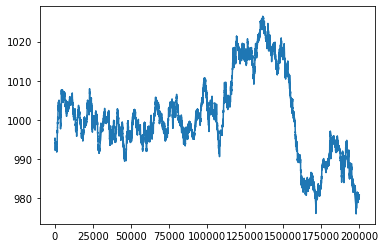

In [6]:
df.y1.plot()

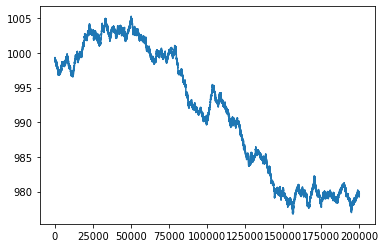

In [7]:
df.x7.plot()

In [8]:
df['target'] = df['y1'].shift(-1)

In [9]:
for i in range(0, 4):
    df["y1_LAG_" + str(i + 1)] = df['y1'].shift(i + 1)

In [10]:
df.head(25)

,x1,x2,x3,x4,x5,x6,x7,x8,s1,s2,y1,target,y1_LAG_1,y1_LAG_2,y1_LAG_3,y1_LAG_4
0,996.7459,1001.2642,999.1467,997.4923,999.7231,1000.8404,999.3012,998.4121,0.0,1.0,995.2712,995.2380,NaN,NaN,NaN,NaN
1,996.6976,1001.2588,999.1436,997.5075,999.7024,1000.8533,999.3144,998.4018,0.0,1.0,995.2380,995.2146,995.2712,NaN,NaN,NaN
2,996.6631,1001.2644,999.1461,997.4998,999.7481,1000.8321,999.3057,998.4034,0.0,1.0,995.2146,995.1892,995.2380,995.2712,NaN,NaN
3,996.6342,1001.2723,999.1480,997.5134,999.7333,1000.8421,999.2866,998.4075,0.0,1.0,995.1892,995.1890,995.2146,995.2380,995.2712,NaN
4,996.6195,1001.2735,999.1411,997.5150,999.7638,1000.8392,999.2458,998.4168,0.0,1.0,995.1890,995.1792,995.1892,995.2146,995.2380,995.2712
5,996.5984,1001.2760,999.1289,997.5186,999.7317,1000.8044,999.2330,998.4262,0.0,1.0,995.1792,995.1608,995.1890,995.1892,995.2146,995.2380
6,996.5822,1001.2686,999.1458,997.4887,999.7287,1000.7895,999.2396,998.4501,0.0,1.0,995.1608,995.1381,995.1792,995.1890,995.1892,995.2146
7,996.5425,1001.2648,999.1326,997.4808,999.7178,1000.7764,999.2467,998.4143,0.0,1.0,995.1381,995.0964,995.1608,995.1792,995.1890,995.1892
8,996.5126,1001.2512,999.1480,997.4514,999.7165,1000.7902,999.2356,998.3911,0.0,1.0,995.0964,995.0622,995.1381,995.1608,995.1792,995.1890
9,996.4841,1001.2554,999.1468,997.4388,999.7332,1000.8041,999.2345,998.3945,0.0,1.0,995.0622,995.0396,995.0964,995.1381,995.1608,995.1792


In [11]:
df['EMA_9'] = df['y1'].ewm(9).mean().shift()
df['SMA_5'] = df['y1'].rolling(5).mean().shift()
df['SMA_10'] = df['y1'].rolling(10).mean().shift()
df['SMA_15'] = df['y1'].rolling(15).mean().shift()
df['SMA_30'] = df['y1'].rolling(30).mean().shift()

In [12]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Scatter(y=df.EMA_9, name='EMA 9'))

In [13]:
def relative_strength_idx(df, n=14):
    target = df['y1']
    delta = target.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(n).mean()
    rollDown = pricesDown.abs().rolling(n).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    return rsi

df['RSI'] = relative_strength_idx(df).fillna(0)


In [14]:
EMA_12 = pd.Series(df['y1'].ewm(span=12, min_periods=12).mean())
EMA_26 = pd.Series(df['y1'].ewm(span=26, min_periods=26).mean())
df['MACD'] = pd.Series(EMA_12 - EMA_26)
df['MACD_signal'] = pd.Series(df.MACD.ewm(span=9, min_periods=9).mean())

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(y=df.y1, name='y1'), row=1, col=1)

fig.add_trace(go.Scatter(y=df['MACD_signal'], name='Signal line'), row=2, col=1)
fig.show()

In [15]:
df['pct_change'] = df['y1'].pct_change()

In [16]:
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)

In [17]:
df.head()

,x1,x2,x3,x4,x5,x6,x7,x8,s1,s2,y1,target,y1_LAG_1,y1_LAG_2,y1_LAG_3,y1_LAG_4,EMA_9,SMA_5,SMA_10,SMA_15,SMA_30,RSI,MACD,MACD_signal,pct_change
0,996.5489,1001.3792,999.1191,997.3702,999.7849,1000.6926,999.2664,998.5637,0.0,1.0,994.9851,994.9824,995.0159,994.9904,994.9999,994.9395,994.933465,994.96762,994.92393,994.896487,994.960017,77.774194,0.002780,-0.013105,-0.000031
1,996.5434,1001.3984,999.1187,997.3698,999.7652,1000.6863,999.2704,998.5699,0.0,1.0,994.9824,994.9709,994.9851,995.0159,994.9904,994.9999,994.938776,994.98616,994.93570,994.905593,994.953213,76.077514,0.005390,-0.008961,-0.000003
2,996.5448,1001.4128,999.0848,997.3674,999.7778,1000.6954,999.2793,998.5526,0.0,1.0,994.9709,994.9369,994.9824,994.9851,995.0159,994.9904,994.943250,994.99474,994.94607,994.916893,994.946327,68.747649,0.006504,-0.005577,-0.000012
3,996.5558,1001.4398,999.1109,997.3785,999.8278,1000.6869,999.2906,998.5387,0.0,1.0,994.9369,994.9802,994.9709,994.9824,994.9851,995.0159,994.946079,994.98894,994.95455,994.926533,994.939383,65.802736,0.004733,-0.003363,-0.000034
4,996.5522,1001.4569,999.1153,997.3798,999.7810,1000.6884,999.2993,998.5472,0.0,1.0,994.9802,994.9903,994.9369,994.9709,994.9824,994.9851,994.945142,994.97824,994.96028,994.930913,994.931920,68.626156,0.006577,-0.001259,0.000044


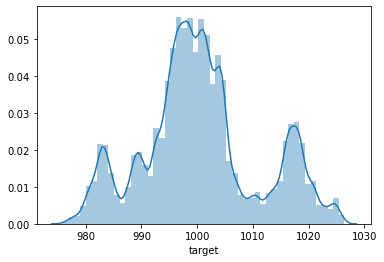

In [18]:
sns.distplot(df['target'])

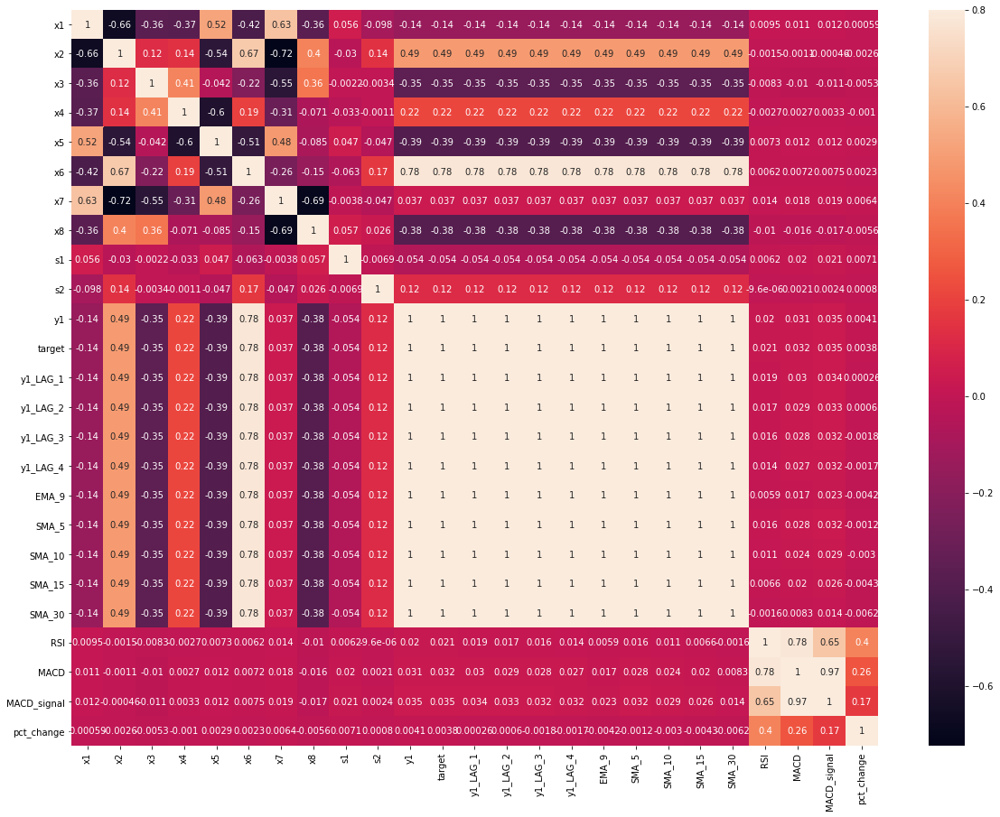

In [19]:
f, ax = plt.subplots(figsize=(20, 15))
sns.heatmap(df.corr(), vmax=.8, annot=True);

In [20]:
df.shape

(199966, 25)

In [21]:
test_size  = 0.15

test_split_idx  = int(df.shape[0] * (1-test_size))

train_df  = df.iloc[:test_split_idx].copy()
test_df   = df.iloc[test_split_idx+1:].copy()

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.index, y=train_df.target, name='Training'))
fig.add_trace(go.Scatter(x=test_df.index,  y=test_df.target,  name='Test'))
fig.show()

In [22]:
y_train = train_df['target'].copy()
X_train = train_df.drop(['target'], 1)

y_test  = test_df['target'].copy()
X_test  = test_df.drop(['target'], 1)

X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169971 entries, 0 to 169970
Data columns (total 24 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   x1           169971 non-null  float64
 1   x2           169971 non-null  float64
 2   x3           169971 non-null  float64
 3   x4           169971 non-null  float64
 4   x5           169971 non-null  float64
 5   x6           169971 non-null  float64
 6   x7           169971 non-null  float64
 7   x8           169971 non-null  float64
 8   s1           169971 non-null  float64
 9   s2           169971 non-null  float64
 10  y1           169971 non-null  float64
 11  y1_LAG_1     169971 non-null  float64
 12  y1_LAG_2     169971 non-null  float64
 13  y1_LAG_3     169971 non-null  float64
 14  y1_LAG_4     169971 non-null  float64
 15  EMA_9        169971 non-null  float64
 16  SMA_5        169971 non-null  float64
 17  SMA_10       169971 non-null  float64
 18  SMA_15       169971 non-

In [23]:
def print_evaluate(true, predicted):  
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('R2 Square', r2_square)

In [24]:
pipeline = Pipeline([
    ('std_scalar', StandardScaler())
])

X_train = pipeline.fit_transform(X_train)
X_test = pipeline.transform(X_test)

# Подбираем модель

In [25]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(X_train, y_train)


test_pred = lr.predict(X_test)
train_pred = lr.predict(X_train)

print('Test set evaluation:\n_____________________________________')
print_evaluate(y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(y_train, train_pred)

Test set evaluation:
_____________________________________
MAE: 0.02260011207316571
MSE: 0.000943168022921551
RMSE: 0.030711040733285986
R2 Square 0.9999626013010194
Train set evaluation:
_____________________________________
MAE: 0.022488108663401236
MSE: 0.0009505117428776448
RMSE: 0.030830370462867372
R2 Square 0.9999892739326982


In [26]:
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {test_pred[:5]}')

y_true = [983.2031 983.2238 983.238  983.2533 983.25  ]
y_pred = [983.20592525 983.20818749 983.21720037 983.24789017 983.2599162 ]


In [27]:
model = Ridge(alpha=100, solver='cholesky', tol=0.0001, random_state=42)

model.fit(X_train, y_train)
pred = model.predict(X_test)


train_pred = model.predict(X_train)
test_pred = model.predict(X_test)


print('Train set evaluation:\n_____________________________________')
print_evaluate(y_train, train_pred)

print('Test set evaluation:\n_____________________________________')
print_evaluate(y_test, test_pred)
print('====================================')


Train set evaluation:
_____________________________________
MAE: 0.03845209580135506
MSE: 0.0025456817352208605
RMSE: 0.05045474938220247
R2 Square 0.9999712732074848
Test set evaluation:
_____________________________________
MAE: 0.038860802415485333
MSE: 0.0025795489424808196
RMSE: 0.05078926010960211
R2 Square 0.9998977151768709


In [28]:
from sklearn.linear_model import RANSACRegressor

model = RANSACRegressor(base_estimator=LinearRegression(), max_trials=100)
model.fit(X_train, y_train)

test_pred = model.predict(X_test)
train_pred = model.predict(X_train)

print('Test set evaluation:\n_____________________________________')
print_evaluate(y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(y_train, train_pred)

Test set evaluation:
_____________________________________
MAE: 0.02260011207316674
MSE: 0.000943168022921602
RMSE: 0.030711040733286815
R2 Square 0.9999626013010194
Train set evaluation:
_____________________________________
MAE: 0.02248810866340118
MSE: 0.0009505117428776467
RMSE: 0.0308303704628674
R2 Square 0.9999892739326982


In [29]:
from sklearn.preprocessing import PolynomialFeatures

poly_reg = PolynomialFeatures(degree=2)

X_train_2_d = poly_reg.fit_transform(X_train)
X_test_2_d = poly_reg.transform(X_test)

lin_reg = LinearRegression(normalize=True)
lin_reg.fit(X_train_2_d,y_train)

test_pred = lin_reg.predict(X_test_2_d)
train_pred = lin_reg.predict(X_train_2_d)

print('Test set evaluation:\n_____________________________________')
print_evaluate(y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(y_train, train_pred)

Test set evaluation:
_____________________________________
MAE: 0.022509756125572242
MSE: 0.0009358049471392624
RMSE: 0.030590929164366065
R2 Square 0.9999628932632658
Train set evaluation:
_____________________________________
MAE: 0.022196868065088683
MSE: 0.0009293300997214903
RMSE: 0.030484915937582808
R2 Square 0.9999895129573413


In [30]:
from sklearn.preprocessing import PolynomialFeatures

poly_reg = PolynomialFeatures(degree=3)

X_train_2_d = poly_reg.fit_transform(X_train)
X_test_2_d = poly_reg.transform(X_test)

lin_reg = LinearRegression(normalize=True)
lin_reg.fit(X_train_2_d,y_train)

test_pred = lin_reg.predict(X_test_2_d)
train_pred = lin_reg.predict(X_train_2_d)

print('Test set evaluation:\n_____________________________________')
print_evaluate(y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(y_train, train_pred)

Test set evaluation:
_____________________________________
MAE: 0.052209389040055544
MSE: 0.00603399715312805
RMSE: 0.07767880761911868
R2 Square 0.99976073866194
Train set evaluation:
_____________________________________
MAE: 0.021965398069800104
MSE: 0.000900697319187513
RMSE: 0.03001161973615408
R2 Square 0.9999898360644816


In [31]:
from sklearn.linear_model import SGDRegressor

sgd_reg = SGDRegressor(n_iter_no_change=250, penalty=None, eta0=0.0001, max_iter=100000)
sgd_reg.fit(X_train, y_train)

test_pred = sgd_reg.predict(X_test)
train_pred = sgd_reg.predict(X_train)

print('Test set evaluation:\n_____________________________________')
print_evaluate(y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(y_train, train_pred)

Test set evaluation:
_____________________________________
MAE: 0.04335141510207633
MSE: 0.003178128645921052
RMSE: 0.056374893755297244
R2 Square 0.9998739801672005
Train set evaluation:
_____________________________________
MAE: 0.04315477250488893
MSE: 0.0032226329401153046
RMSE: 0.056768238832249365
R2 Square 0.9999636341391218


In [32]:
from sklearn.linear_model import Ridge
from sklearn import metrics

model = Ridge(alpha=100, solver='cholesky', tol=0.0001, random_state=42)

model.fit(X_train, y_train)
pred = model.predict(X_test)


train_pred = model.predict(X_train)
test_pred = model.predict(X_test)


print('Train set evaluation:\n_____________________________________')
print_evaluate(y_train, train_pred)

print('Test set evaluation:\n_____________________________________')
print_evaluate(y_test, test_pred)
print('====================================')

Train set evaluation:
_____________________________________
MAE: 0.03845209580135506
MSE: 0.0025456817352208605
RMSE: 0.05045474938220247
R2 Square 0.9999712732074848
Test set evaluation:
_____________________________________
MAE: 0.038860802415485333
MSE: 0.0025795489424808196
RMSE: 0.05078926010960211
R2 Square 0.9998977151768709


In [33]:
# Я выбрал полиномиальную линейную регрессию, так как она показывает лучшие результаты на тестовых данных

poly_reg = PolynomialFeatures(degree=3)
lin_reg = LinearRegression(normalize=True)

X_train_2_d = poly_reg.fit_transform(X_train)
lin_reg.fit(X_train_2_d,y_train)

LinearRegression(normalize=True)

# Торговый алгоритм

In [34]:
#Identifying signals and calculating daily return
# задаем начальное значение торгового сигнала - "без сигнала"
tickers_signal = "No signal"
# профит или убыток записывается в этот массив
tickers_ret = []
comission = 0.0001

# проходимся в цикле по тестовому датасету для бектеста стратегии
for i in range(len(X_test)):

#     текущая цена актива
    current_price = pipeline.inverse_transform(X_test)[i][10]
    
#     предиктим цену на следующий момент ремени
    X_test_2_d = poly_reg.fit_transform(X_test[i].reshape(1, -1))
    test_pred = lin_reg.predict(X_test_2_d)


    if tickers_signal == "No signal":
        tickers_ret.append(0)
         
#             если прогноз выше, чем на цену комиссии, встаем в лонг
        if test_pred > current_price + current_price * comission:
            tickers_signal = "Buy"
            position = current_price + current_price * comission
            
 #             если прогноз ниже, чем на цену комиссии, встаем в шорт
        elif test_pred < current_price - current_price * comission:
            tickers_signal = "Sell"
            position = current_price - current_price * comission
            
#     если находимся в лонге,а прогноз показывает падение на цену выше комиссии,
    elif tickers_signal == "Buy" and test_pred < current_price - current_price * comission:
#         то закрываем позицию
        tickers_ret.append((current_price/position)-1)
#         и встаём в шорт
        tickers_signal = "Sell"
        position = current_price - current_price * comission
        
#    если находимся в шорте, а прогноз показывает рост цены выше, чем размер комиссии 
    elif tickers_signal == "Sell" and test_pred > current_price + current_price * comission:
#         то закрываем позицию
        tickers_ret.append(((position)/current_price)-1)
#     и встаем в лонг
        tickers_signal = "Buy"
        position = current_price + current_price * comission

In [35]:
print('было сделано трейдов {}'.format(len(tickers_ret)))

было сделано трейдов 1653


In [36]:
sum(tickers_ret)

0.038687466789380065

In [37]:
strategy_df = pd.DataFrame()

strategy_df['ret'] = np.array(tickers_ret)

# Сколько прибыли заработали по итогу
(1+strategy_df["ret"]).cumprod().tail()

1648    1.023793
1649    1.028023
1650    1.027865
1651    1.031188
1652    1.039351
Name: ret, dtype: float64

In [38]:
def max_dd(DF):
    "function to calculate max drawdown"
    df = DF.copy()
    df["cum_return"] = (1 + df["ret"]).cumprod()
    df["cum_roll_max"] = df["cum_return"].cummax()
    df["drawdown"] = df["cum_roll_max"] - df["cum_return"]
    df["drawdown_pct"] = df["drawdown"]/df["cum_roll_max"]
    max_dd = df["drawdown_pct"].max()
    return max_dd

In [39]:
# максимальная просадка
max_drawdown =  max_dd(strategy_df)
print(max_drawdown)

0.0026872588975156773
